<a href="https://colab.research.google.com/github/OrgadShlishman/FastDup/blob/main/BottlesDetection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 1. Detecting bottles in trash and sharpening images:

#### 1.1 Setting up environment

In [ ]:
import torch
from PIL import Image, ImageFilter

!git clone https://github.com/ultralytics/yolov5.git


Cloning into 'yolov5'...
remote: Enumerating objects: 17093, done.
remote: Counting objects: 100% (49/49), done.
remote: Compressing objects: 100% (37/37), done.
remote: Total 17093 (delta 36), reused 12 (delta 12), pack-reused 17044 (from 2)
Receiving objects: 100% (17093/17093), 15.70 MiB | 20.64 MiB/s, done.
Resolving deltas: 100% (11735/11735), done.


#### 1.2 Loading YOLO NN

In [ ]:
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')  # You can use 'yolov5m', 'yolov5l', or 'yolov5x' for larger models

/usr/local/lib/python3.10/dist-packages/torch/hub.py:330: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


YOLOv5 🚀 2025-1-9 Python-3.10.12 torch-2.5.1+cu121 CPU

100%|██████████| 14.1M/14.1M [00:00<00:00, 128MB/s]

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


#### 1.3 Auxilary Functions

In [ ]:
def sharpen_image(image_path):
    """
    Apply unsharp masking to an image.
    """
    img = Image.open(image_path)
    return img.filter(ImageFilter.UnsharpMask(radius=8, percent=160, threshold=5))

def run_inference(image):
    # Perform inference
    results = model(image)
    return results

#### 1.4 Adding testing images

In [ ]:
!wget -O /content/temp_image1.jpg 'https://media.npr.org/assets/img/2024/01/09/gettyimages-1258833682-bdd8ee9eddc072e4ffe6590b7e7c3a58cfe4f54a.jpg'
!wget -O /content/temp_image2.jpg 'https://www.shutterstock.com/image-photo/plastic-bottle-on-street-blurry-260nw-1124703005.jpg'

!wget -O /content/temp_image3.jpg 'https://www.shutterstock.com/shutterstock/photos/2112828356/display_1500/stock-photo-blurred-counter-has-a-wide-variety-of-liquor-bottles-that-are-sold-in-supermarkets-blur-bottles-of-2112828356.jpg'
!wget -O /content/temp_image4.jpg 'https://images.stockcake.com/public/9/b/0/9b0615bc-e810-4a0d-a372-0ef2cd5a4f2a_large/filling-water-bottle-stockcake.jpg'

# List of image paths
image_paths = ['/content/temp_image1.jpg', '/content/temp_image2.jpg', '/content/temp_image3.jpg', '/content/temp_image4.jpg']

--2025-01-09 19:20:53--  https://media.npr.org/assets/img/2024/01/09/gettyimages-1258833682-bdd8ee9eddc072e4ffe6590b7e7c3a58cfe4f54a.jpg
Resolving media.npr.org (media.npr.org)... 23.211.118.65, 23.211.118.43, 2600:1408:10::b833:65da, ...
Connecting to media.npr.org (media.npr.org)|23.211.118.65|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2700826 (2.6M) [image/jpeg]
Saving to: ‘/content/temp_image1.jpg’

/content/temp_image 100%[===================>]   2.58M  --.-KB/s    in 0.1s    

2025-01-09 19:20:53 (22.3 MB/s) - ‘/content/temp_image1.jpg’ saved [2700826/2700826]

--2025-01-09 19:20:53--  https://www.shutterstock.com/image-photo/plastic-bottle-on-street-blurry-260nw-1124703005.jpg
Resolving www.shutterstock.com (www.shutterstock.com)... 3.161.193.112, 3.161.193.27, 3.161.193.4, ...
Connecting to www.shutterstock.com (www.shutterstock.com)|3.161.193.112|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 27136 (26K) [image/jpeg]
Sa

#### 1.5 Running main code and displaying results


**In the following results one can see:**

(1) Original Image shows better results than sharpened one

(2) Original and sharpened results are the same

(3) Original image detect few bottles, sharpened image detect more bottles

(4) Original image doesn't detect the bottle, sharpened image detect it

Processing image: /content/temp_image1.jpg


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Inference on original image:


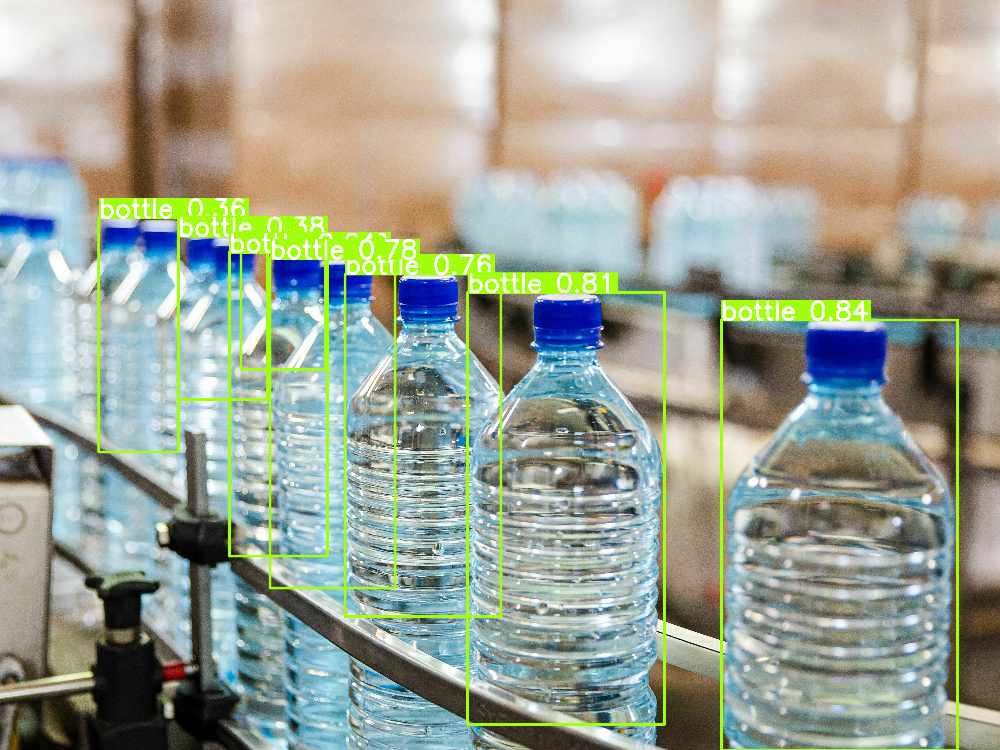

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Inference on sharpened image:
Buffered data was truncated after reaching the output size limit.

In [ ]:
for img_path in image_paths:
    print(f"Processing image: {img_path}")

    # Display original image
    # original_img = Image.open(img_path)
    # display(original_img)

    # Run inference on the original image
    results = run_inference(img_path)
    print("Inference on original image:")
    results.show()

    # Sharpen the image
    sharpened_img = sharpen_image(img_path)

    # Save the sharpened image to a temporary path
    sharpened_img_path = f'/{img_path[1:-4]}_sharp.jpg'
    sharpened_img.save(sharpened_img_path)

    # Display sharpened image
    # print(f"Processing sharpened image: {sharpened_img_path}")
    # display(sharpened_img)

    # Run inference on the sharpened image
    results = run_inference(sharpened_img_path)
    print("Inference on sharpened image:")
    results.show()
